# Prepare SpaceNet 7 Data for Model Training



In [2]:
import pandas as pd
import torch as t
import torch.nn as nn
import tensorflow as tf

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:529: FutureWarning: Passing (type, 1) or 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!nvidia-smi
#Check cuda version
is_cuda_available=t.cuda.is_available()
print(is_cuda_available)
# Generalize cuda for all comands without writing .cuda()
device = t.device('cuda:0') 
t.cuda.set_device(device)

Tue Apr 27 23:37:30 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
% cd /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline

/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline


In [3]:
# RUN ONLY ONCE
# Download desired version for GDAL
!wget http://download.osgeo.org/gdal/3.0.4/gdal-3.0.4.tar.gz
!tar zxvf gdal-3.0.4.tar.gz
# RUN ONLY ONCE
# First install GDAL version above 3.0.0, since lower versions are not compatible with Solaris and creates error "gdal wheel". Therefore, first add desired version and then update command (generelize), otherwise it will install smaller versions
# If the commands below doesn't work, test wit:
# !pip install --global-option=build_ext --global-option="-I/usr/include/gdal" GDAL==`gdal-config --version`
# Otherwise:
!add-apt-repository ppa:ubuntugis/ubuntugis-unstable

!apt-get install gdal-bin

!apt-get install python3-gdal

!apt-get install python3-numpy

# RUN ONLY ONCE
# Missing dependencies - check here version is above 3.0, otherwise won't work
!pip install --global-option=build_ext --global-option="-I/usr/include/gdal" GDAL==`gdal-config --version`
!gdalinfo --version

# test gdal
import gdal

--2021-04-27 21:49:13--  http://download.osgeo.org/gdal/3.0.4/gdal-3.0.4.tar.gz
Resolving download.osgeo.org (download.osgeo.org)... 140.211.15.30
Connecting to download.osgeo.org (download.osgeo.org)|140.211.15.30|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14379480 (14M) [application/octet-stream]
Saving to: ‘gdal-3.0.4.tar.gz’

gdal-3.0.4.tar.gz   100%[===================>]  13.71M  3.20MB/s    in 4.1s    

2021-04-27 21:49:17 (3.33 MB/s) - ‘gdal-3.0.4.tar.gz’ saved [14379480/14379480]

gdal-3.0.4/
gdal-3.0.4/ogr/
gdal-3.0.4/ogr/style_pen1.gif
gdal-3.0.4/ogr/ogrpgeogeometry.h
gdal-3.0.4/ogr/ogrcompoundcurve.cpp
gdal-3.0.4/ogr/ogr_xerces.cpp
gdal-3.0.4/ogr/ogrfeaturestyle.cpp
gdal-3.0.4/ogr/ogrcurvepolygon.cpp
gdal-3.0.4/ogr/ogr_api.h
gdal-3.0.4/ogr/ogr_api.cpp
gdal-3.0.4/ogr/ogr_drivertut.dox
gdal-3.0.4/ogr/wktproblems.html
gdal-3.0.4/ogr/swq_parser.cpp
gdal-3.0.4/ogr/ogr_xerces.h
gdal-3.0.4/ogr/swq_parser.hpp
gdal-3.0.4/ogr/ogr_geos.h
gdal-3.0.4/ogr/ogr

In [4]:
# RUN ONLY ONCE
#!pip install GDAL - RUN ONLY ONCE
#!gdal-config --version
!pip install geopandas

import geopandas as gpd

# Test geojson
!geos-config --version
!whereis geos-config
!make distclean

!pip install git+git://github.com/geopandas/geopandas.git

# RUN TWICE ONCE (with warmings) and restart runtime, then re-run this cell again
!pip install solaris

     |████████████████████████████████| 1.0MB 17.5MB/s 
     |████████████████████████████████| 6.5MB 48.0MB/s 
     |████████████████████████████████| 15.3MB 206kB/s 
3.8.0
geos-config: /usr/bin/geos-config /usr/share/man/man1/geos-config.1.gz
make: *** No rule to make target 'distclean'.  Stop.
  Cloning git://github.com/geopandas/geopandas.git to /tmp/pip-req-build-qwwx5djh
  Running command git clone -q git://github.com/geopandas/geopandas.git /tmp/pip-req-build-qwwx5djh
  Created wheel for geopandas: filename=geopandas-0.9.0+14.g294ba75-py2.py3-none-any.whl size=995262 sha256=0af2babde6c036a7bd53012476bb3ac7f0258605550b27ac5853a5e97957ae7d
  Stored in directory: /tmp/pip-ephem-wheel-cache-h0qr77dp/wheels/91/24/71/376c9c67192694168352afcccc2d264248f7e2cc6192997186
Successfully built geopandas
  Found existing installation: geopandas 0.9.0
    Uninstalling geopandas-0.9.0:
      Successfully uninstalled geopandas-0.9.0


     |████████████████████████████████| 17.8MB 203kB/s 
     |████████████████████████████████| 153kB 57.7MB/s 
     |████████████████████████████████| 19.1MB 1.2MB/s 
     |████████████████████████████████| 61kB 7.8MB/s 
     |████████████████████████████████| 266kB 56.1MB/s 
     |████████████████████████████████| 1.0MB 46.1MB/s 
     |████████████████████████████████| 3.2MB 48.2MB/s 
     |████████████████████████████████| 92.6MB 48kB/s 
     |████████████████████████████████| 61kB 8.8MB/s 
     |████████████████████████████████| 634kB 44.7MB/s 
     |████████████████████████████████| 368kB 35.7MB/s 
     |████████████████████████████████| 51kB 7.9MB/s 
     |████████████████████████████████| 3.2MB 47.4MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.2-cp37-cp37m-linux_x86_64.whl size=44209 sha256=a17a64f65d971b3abe1e87f0b65a028b7519973a042d41e5252ed31dba0830d4
  Stored in directory: /root/.cache/pip/wheels/54/b7/c7/2ada654ee54483c9329871665aaf4a6056c3ce36f29cf66e67
  Created whe

In [4]:
import solaris as sol
print(sol.__version__)
!gdalinfo --version

0.4.0
GDAL 3.0.4, released 2020/01/28


### load other libraries

In [6]:
% cd /content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline

/content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline


In [5]:
import multiprocessing
import pandas as pd
import numpy as np
import skimage
import gdal
import sys
import os

import matplotlib as mpl
import matplotlib.cm as cmx
import matplotlib.pyplot as plt
import matplotlib.colors as colors
plt.rcParams.update({'font.size': 16})
mpl.rcParams['figure.dpi'] = 300

import solaris as sol
from solaris.raster.image import create_multiband_geotiff
from solaris.utils.core import _check_gdf_load

# import from data_prep_funcs
module_path = os.path.abspath(os.path.join('/content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/src/'))
if module_path not in sys.path:
    sys.path.append(module_path)


In [17]:
% cd /content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/src/

/content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/src


In [18]:
from sn7_baseline_prep_funcs import map_wrapper, make_geojsons_and_masks

In [19]:
# Dataset location (edit as needed)
root_dir = '/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train'

--------
### Create training Masks

We will use 25 data cubes for training phase and store 15 for testing

In [20]:
# Create Training Masks
# Multi-thread to increase speed
# We'll only make a 1-channel mask for now, but Solaris supports a multi-channel mask as well, see
#     https://github.com/CosmiQ/solaris/blob/master/docs/tutorials/notebooks/api_masks_tutorial.ipynb
# List all training aois
aois = sorted([f for f in os.listdir(os.path.join(root_dir, 'train_final'))
               if os.path.isdir(os.path.join(root_dir, 'train_final', f))])

print(aois)
print("Printing over 1 channel")
n_threads = 10
params = [] 
make_fbc = False

input_args = []

['L15-0595E-1278N_2383_3079_13', 'L15-0614E-0946N_2459_4406_13', 'L15-0632E-0892N_2528_4620_13', 'L15-0683E-1006N_2732_4164_13', 'L15-0760E-0887N_3041_4643_13', 'L15-0924E-1108N_3699_3757_13', 'L15-0977E-1187N_3911_3441_13', 'L15-1014E-1375N_4056_2688_13', 'L15-1015E-1062N_4061_3941_13', 'L15-1025E-1366N_4102_2726_13', 'L15-1049E-1370N_4196_2710_13', 'L15-1138E-1216N_4553_3325_13', 'L15-1172E-1306N_4688_2967_13', 'L15-1185E-0935N_4742_4450_13', 'L15-1200E-0847N_4802_4803_13', 'L15-1203E-1203N_4815_3378_13', 'L15-1204E-1202N_4816_3380_13', 'L15-1204E-1204N_4819_3372_13', 'L15-1209E-1113N_4838_3737_13', 'L15-1210E-1025N_4840_4088_13', 'L15-1276E-1107N_5105_3761_13', 'L15-1289E-1169N_5156_3514_13', 'L15-1296E-1198N_5184_3399_13', 'L15-1298E-1322N_5193_2903_13', 'L15-1335E-1166N_5342_3524_13', 'L15-1389E-1284N_5557_3054_13', 'L15-1438E-1134N_5753_3655_13', 'L15-1439E-1134N_5759_3655_13', 'L15-1479E-1101N_5916_3785_13', 'L15-1481E-1119N_5927_3715_13', 'L15-1538E-1163N_6154_3539_13', 'L15-16

In [21]:
for i, aoi in enumerate(aois):
    print(i, "aoi:", aoi)
    im_dir = os.path.join(root_dir, 'train_final', aoi, 'images_masked/')
    json_dir = os.path.join(root_dir, 'train_final', aoi, 'labels_match/')
    out_dir_mask = os.path.join(root_dir, 'train_final', aoi, 'masks/')
    out_dir_mask_fbc = os.path.join(root_dir, 'train_final', aoi, 'masks_fbc/')
    os.makedirs(out_dir_mask, exist_ok=True)
    if make_fbc:
        os.makedirs(out_dir_mask_fbc, exist_ok=True)
    json_files = sorted([f
                for f in os.listdir(os.path.join(json_dir))
                if f.endswith('Buildings.geojson') and os.path.exists(os.path.join(json_dir, f))])
    for j, f in enumerate(json_files):
        # print(i, j, f)
        name_root = f.split('.')[0]
        json_path = os.path.join(json_dir, f)
        image_path = os.path.join(im_dir, name_root + '.tif').replace('labels', 'images').replace('_Buildings', '')
        output_path_mask = os.path.join(out_dir_mask, name_root + '.tif')
        if make_fbc:
            output_path_mask_fbc = os.path.join(out_dir_mask_fbc, name_root + '.tif')
        else:
            output_path_mask_fbc = None
            
        if (os.path.exists(output_path_mask)):
             continue
        else: 
            input_args.append([make_geojsons_and_masks, 
                               name_root, image_path, json_path,
                               output_path_mask, output_path_mask_fbc])

# execute 
print("len input_args", len(input_args))
print("Execute...\n")
print("hecho!")

# Masks are aready created, therefore execute once.
#with multiprocessing.Pool(n_threads) as pool:
#  pool.map(map_wrapper, input_args)

0 aoi: L15-0595E-1278N_2383_3079_13
1 aoi: L15-0614E-0946N_2459_4406_13
2 aoi: L15-0632E-0892N_2528_4620_13
3 aoi: L15-0683E-1006N_2732_4164_13
4 aoi: L15-0760E-0887N_3041_4643_13
5 aoi: L15-0924E-1108N_3699_3757_13
6 aoi: L15-0977E-1187N_3911_3441_13
7 aoi: L15-1014E-1375N_4056_2688_13
8 aoi: L15-1015E-1062N_4061_3941_13
9 aoi: L15-1025E-1366N_4102_2726_13
10 aoi: L15-1049E-1370N_4196_2710_13
11 aoi: L15-1138E-1216N_4553_3325_13
12 aoi: L15-1172E-1306N_4688_2967_13
13 aoi: L15-1185E-0935N_4742_4450_13
14 aoi: L15-1200E-0847N_4802_4803_13
15 aoi: L15-1203E-1203N_4815_3378_13
16 aoi: L15-1204E-1202N_4816_3380_13
17 aoi: L15-1204E-1204N_4819_3372_13
18 aoi: L15-1209E-1113N_4838_3737_13
19 aoi: L15-1210E-1025N_4840_4088_13
20 aoi: L15-1276E-1107N_5105_3761_13
21 aoi: L15-1289E-1169N_5156_3514_13
22 aoi: L15-1296E-1198N_5184_3399_13
23 aoi: L15-1298E-1322N_5193_2903_13
24 aoi: L15-1335E-1166N_5342_3524_13
25 aoi: L15-1389E-1284N_5557_3054_13
26 aoi: L15-1438E-1134N_5753_3655_13
27 aoi: L15

### Extraction of identifiers (visualization purposes)

Only use one image, but from here we can see that the whole tile is plotted, not the chunks. So the difference with *tiling an image* is that on this we get a whole tile and split it into smaller chunks. On this case, we have downloaded already the training sets, so we just need to read them and make sure that images and labels match.

In [ ]:
# make identifier plots

#aoi = 'L15-0358E-1220N_1433_3310_13'
aoi = 'L15-0595E-1278N_2383_3079_13'
im_dir = os.path.join(root_dir, 'train_final', aoi, 'images_masked')
json_dir = os.path.join(root_dir, 'train_final', aoi, 'labels_match/')

# colors
vmax = 200
cmap = plt.get_cmap('hsv')  # 'jet'
cNorm  = colors.Normalize(vmin=0, vmax=vmax)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=cmap)
plot_only_first_and_last = True
label_font_size = 4
im_pix_size_x, im_pix_size_y = 1024, 1024
figsize=(20,20)

json_files = sorted([f
            for f in os.listdir(json_dir)
            if f.endswith('Buildings.geojson') and os.path.exists(os.path.join(json_dir, f))])
if plot_only_first_and_last:
    json_files = [json_files[0], json_files[-1]]

# convert json
for j, f in enumerate(json_files):
    # print(i, j, f)
    name_root = f.split('.')[0]
    json_path = os.path.join(json_dir, f)
    image_path = os.path.join(im_dir, name_root + '.tif').replace('_Buildings', '')
    print("name_root:", name_root)
    # print("json_path", json_path)
    # output_path = os.path.join(out_dir, f)
    # if os.path.exists(output_path):
    #    print("  path exists, skipping:", name_root)
    #    continue
    gdf_pix = sol.vector.polygon.geojson_to_px_gdf(json_path, image_path, geom_col='geometry', precision=None,
                  output_path=None, override_crs=False)
    fig, ax = plt.subplots(figsize=figsize)
    for _, row in gdf_pix.iterrows():
        geom = row['geometry']
        poly_id = row['Id']
        x, y = geom.exterior.xy
        cx, cy = np.array(geom.centroid.xy).astype(float)
        #print("centroid:", centroid)
        color_int = int(poly_id) % vmax
        colorVal = scalarMap.to_rgba(color_int)
        ax.plot(x, y, c=colorVal)
        # poly id
        ax.annotate(str(poly_id), xy=(cx, cy), ha='center', size=label_font_size)
        #text_object = plt.annotate(label, xy=(x_values[i], y_values[i]), ha='center')
        #ax.text(cx, cy, str(poly_id))
    ax.set_xlim(0, im_pix_size_x)
    ax.set_ylim(0, im_pix_size_y)
    title = str(j) + " - " + name_root + " - N buildings = " + str(len(gdf_pix))
    ax.set_title(title)
    print("Adding")
    plt.show()

Create images using masks from the training set.

In [ ]:
# Inspect visually

im_dir = os.path.join(root_dir, 'train_final', aoi, 'images_masked')
mask_dir = os.path.join(root_dir, 'train_final', aoi, 'masks')

im_list = sorted([z for z in os.listdir(im_dir) if z.endswith('.tif')])
im_file = im_list[0]

im_path = os.path.join(im_dir, im_file)
print("im_path \n \n \n", im_path)
mask_path = os.path.join(mask_dir, im_file.split('.')[0] + '_Buildings.tif')
print("mask_path", mask_path)

# Read images
im = skimage.io.imread(im_path)
mask = skimage.io.imread(mask_path)

figsize=(24, 12)
name = im_file.split('.')[0].split('global_monthly_')[-1]
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(im)
ax0.set_xticks([])
ax0.set_yticks([])
# _ = ax0.set_title(name)
_ = ax1.imshow(mask)
ax1.set_xticks([])
ax1.set_yticks([])
# _ = ax1.set_title(name)
_ = fig.suptitle(name)
plt.tight_layout()

## Make dataframe csvs for train/testing

This is what we will use to feed the model

We will concatenate the training image (images masked): 

/home/sebasmos/Documentos/TRDP/DATASET/SN7_buildings_train/train/L15-0331E-1257N_1327_3160_13/**images_masked**/global_monthly_2018_01_mosaic_L15-0331E-1257N_1327_3160_13.tif

with its correspondent labeling (mask)

/home/sebasmos/Documentos/TRDP/DATASET/SN7_buildings_train/train/L15-0331E-1257N_1327_3160_13/**masks**/global_monthly_2018_02_mosaic_L15-0331E-1257N_1327_3160_13_Buildings.tif


In [23]:

import os
out_dir = os.path.join(root_dir, 'csvs/')
print(out_dir)
pops = ['train_final', 'validation_final']
os.makedirs(out_dir, exist_ok=True)

/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/csvs/


In [ ]:
for pop in pops: 
    d = os.path.join(root_dir, pop)
    print("d: ",d)
    outpath = os.path.join(out_dir, 'sn7_baseline_' + pop + '_df.csv')
    print("outpath: ",outpath)
    im_list, mask_list = [], []
    subdirs = sorted([f for f in os.listdir(d) if os.path.isdir(os.path.join(d, f))])
    for subdir in subdirs:        
        if pop == 'train_final':            
            im_files = [os.path.join(d, subdir, 'images_masked', f)
                    for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                    if f.endswith('.tif') and os.path.exists(os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif'))]
            #print(im_files)
            mask_files = [os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif')
                      for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                      if f.endswith('.tif') and os.path.exists(os.path.join(d, subdir, 'masks', f.split('.')[0] + '_Buildings.tif'))]
            im_list.extend(im_files)
            mask_list.extend(mask_files)
    
        elif pop == 'validation_final':
            im_files = [os.path.join(d, subdir, 'images_masked', f)
                    for f in sorted(os.listdir(os.path.join(d, subdir, 'images_masked')))
                    if f.endswith('.tif')]
            im_list.extend(im_files)

    # save to dataframes
    print("im_list:", im_list)
    print("mask_list:", mask_list)
    if pop == 'train_final':
        df = pd.DataFrame({'image': im_list, 'label': mask_list})
        display(df.head())
    # Uncomment only once for creating validation set
#    elif pop == 'validation_final':
#      df = pd.DataFrame({'image': im_list})
    df.to_csv(outpath, index=False)
    print(pop, "len df:", len(df))
    print("output csv:", outpath)
    print("working!!")

In [ ]:
# Check sizes are correct: 
train_set = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/csvs/sn7_baseline_train_final_df.csv")
val_set = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/csvs/sn7_baseline_validation_final_df.csv")

print("Length of Training set (# images): ",len(train_set))
print("Length of validation set (# images): ",len(val_set))

In [ ]:
# TODO: change to conda
train_set.head(10)

This dataframe/csvs is storing the matching between our dataframe and its corresponding labeling which contains the building footprint

## Load model main settings (config file) for training stage

In [24]:
path_to_model = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/API/models"

model_name = '/xdxd_spacenet4.yml'

fullpath = "%s%s" % ( path_to_model, model_name ) # for Linux

print(fullpath)

# Update through online editor while hypertunning \ lower batch to 5
config = sol.utils.config.parse(fullpath)
config

/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/API/models/xdxd_spacenet4.yml


{'batch_size': 6,
 'data_specs': {'channels': 4,
  'data_workers': None,
  'dtype': None,
  'height': 512,
  'image_type': 'zscore',
  'is_categorical': False,
  'label_type': 'mask',
  'mask_channels': 1,
  'rescale': False,
  'rescale_maxima': 'auto',
  'rescale_minima': 'auto',
  'val_holdout_frac': 0.2,
  'width': 512},
 'infer': True,
 'inference': {'output_dir': 'inference_out_final/',
  'window_step_size_x': None,
  'window_step_size_y': None},
 'inference_augmentation': {'augmentations': {'DropChannel': {'axis': 2,
    'idx': 3,
    'p': 1.0},
   'Normalize': {'max_pixel_value': 65535.0,
    'mean': [0.006479, 0.009328, 0.01123],
    'p': 1.0,
    'std': [0.004986, 0.004964, 0.00495]}},
  'p': 1.0},
 'inference_data_csv': '/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/csvs/sn7_baseline_validation_final_df.csv',
 'model_name': 'xdxd_spacenet4',
 'model_path': None,
 'nn_framework': 'torch',
 'pretrained': False,
 'train': True,
 'training': {'callb

**Remarks**
Collecting garbage and emptying cuda memory after each epoch to save up memory [See issue](https://github.com/pytorch/pytorch/issues/16417)

Other options:

1.  Decrease the batch size and increase the epochs

2.  If 'CUDA out of memory' error msg pops up even no iteration goes, then check the batch size you set and decrease it.

3.  If 'CUDA out of memory' error msg pops up after some iterations, then check all the variables in the computing graph, and detach the unnecessary variables. I usually run into this situation, e.g., I did not detach the inputs of my measure/loss functions ->  which are not involved in backward propagation.

A practical way to tell what's happening is using nvidia-smi command every few seconds to check whether the CUDA memory usage is increasing. If it is, I think you may run into the second situation.

In [69]:

import gc 

# Your code with pytorch using GPU

gc.collect() 

t.cuda.empty_cache()

In [26]:
trainer = sol.nets.train.Trainer(config)
trainer.train()

Beginning training epoch 0


/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3458: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode)


    loss at batch 0: 10.13850212097168
    loss at batch 10: 7.421911239624023
    loss at batch 20: 4.54683780670166
    loss at batch 30: 4.871789932250977
    loss at batch 40: 4.659162521362305
    loss at batch 50: 5.049867630004883
    loss at batch 60: 5.42572546005249
    loss at batch 70: 4.972709655761719
    loss at batch 80: 5.0307159423828125
    loss at batch 90: 4.080385208129883
    loss at batch 100: 5.775371551513672
    loss at batch 110: 4.481784820556641
    loss at batch 120: 5.69346284866333

    Validation loss at epoch 0: 4.923431873321533

Beginning training epoch 1
    loss at batch 0: 4.604931831359863
    loss at batch 10: 5.457081317901611
    loss at batch 20: 4.755372047424316
    loss at batch 30: 5.245929718017578
    loss at batch 40: 4.079763412475586
    loss at batch 50: 4.565982818603516
    loss at batch 60: 3.7557294368743896
    loss at batch 70: 4.560051441192627
    loss at batch 80: 4.247771263122559
    loss at batch 90: 5.358699798583984
 

 Models stored on /DATASETS/API/trained_models

In [ ]:
# using /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/xdxd_best_epoch1_4.921999931335449.pth

# Running model: Inference — Segmentation Mask

Once training is completed (or pre-trained weights are selected) inference can be initiated via:

In [28]:
% cd /content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/src
!ls

/content/drive/My Drive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/src
__init__.py			sn7_baseline_train.py
__pycache__			xdxd_best_epoch1_4.922999858856201.pth
sn7_baseline_infer.py		xdxd_best_epoch4_4.885000228881836.pth
sn7_baseline_postproc_funcs.py	xdxd.pth
sn7_baseline_prep_funcs.py


The sn7_baseline_infer.py script executes the segmentation model, which is only the first step in the extracting matched building footprints in the data cube. In the cells below, we refine these predictioms masks to the final output.

In [70]:
!pip install tifffile 
!pip install imagecodecs 
import numpy 
import tifffile as tiff 

!ls

In [30]:
!python sn7_baseline_infer.py

/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:529: FutureWarning: Passing (type, 1) or 

*Remarks about inference stage:*

sn7_baseline_infer.py is composed of a yaml file which contains the model parameters. The model can be pre-trained and addressed based on the given path (pre-trained, customized or not). Internally:

```
import solaris as sol

config = sol.utils.config.parse('/path/to/xdxd_spacenet4.yml')

config

trainer = sol.nets.train.Trainer(config)

trainer.train()

```

Check reference in [1](https://solaris.readthedocs.io/en/latest/tutorials/notebooks/api_training_spacenet.html)

For this particular case, the model will be stored in `inference_out/` folder, following a tree structure containing a `raw/` folder, which contains the predictions on the format `global_monthly_2018_04_mosaic_L15-0509E-1108N_2037_3758_13.geojson` which is afterward splited for extracting its aoi (i.e L15-0509E-1108N_2037_3758_13) and subsequently greating the subfolders: `grouped, explore` for visualization and id tracking assignment purposes



--------
## 3. Extract Footprints and Building Identifiers

In [ ]:
!pwd

In [6]:
# Set prediction and image directories (edit appropriately)
pred_top_dir = '/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds'
im_top_dir = '/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final'
#im_top_dir = '/local_data/sn7/aws_download/test_public'

from shapely.ops import cascaded_union
import matplotlib.pyplot as plt
import geopandas as gpd
import multiprocessing
import pandas as pd
import numpy as np
import skimage.io
import tqdm
import glob
import math
import gdal
import time
import sys
import os

import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
import matplotlib
# matplotlib.use('Agg') # non-interactive

import solaris as sol
from solaris.utils.core import _check_gdf_load
from solaris.raster.image import create_multiband_geotiff 

# import from data_postproc_funcs
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)
from sn7_baseline_postproc_funcs import map_wrapper, multithread_polys, \
        calculate_iou, track_footprint_identifiers, \
        sn7_convert_geojsons_to_csv

In [32]:
raw_name = 'raw/'
grouped_name = 'grouped/'
im_list = sorted([z for z in os.listdir(os.path.join(pred_top_dir, raw_name)) if z.endswith('.tif')])
print("im_list: ",im_list)
 

im_list:  ['global_monthly_2017_07_mosaic_L15-1669E-1160N_6678_3548_13.tif', 'global_monthly_2017_07_mosaic_L15-1669E-1160N_6679_3549_13.tif', 'global_monthly_2017_08_mosaic_L15-1615E-1205N_6460_3370_13.tif', 'global_monthly_2017_09_mosaic_L15-1203E-1203N_4815_3378_13.tif', 'global_monthly_2017_10_mosaic_L15-1203E-1203N_4815_3378_13.tif', 'global_monthly_2017_10_mosaic_L15-1615E-1206N_6460_3366_13.tif', 'global_monthly_2017_10_mosaic_L15-1669E-1160N_6678_3548_13.tif', 'global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13.tif', 'global_monthly_2018_01_mosaic_L15-0361E-1300N_1446_2989_13.tif', 'global_monthly_2018_01_mosaic_L15-0368E-1245N_1474_3210_13.tif', 'global_monthly_2018_01_mosaic_L15-0387E-1276N_1549_3087_13.tif', 'global_monthly_2018_01_mosaic_L15-0434E-1218N_1736_3318_13.tif', 'global_monthly_2018_01_mosaic_L15-0457E-1135N_1831_3648_13.tif', 'global_monthly_2018_01_mosaic_L15-0487E-1246N_1950_3207_13.tif', 'global_monthly_2018_01_mosaic_L15-0506E-1204N_2027_3374_13.tif',

In [33]:
df = pd.DataFrame({'image': im_list})
roots = [z.split('mosaic_')[-1].split('.tif')[0] for z in df['image'].values]
print("roots: ", roots)
df['root'] = roots
# copy files
for idx, row in df.iterrows():
    in_path_tmp = os.path.join(pred_top_dir, raw_name, row['image'])
    out_dir_tmp = os.path.join(pred_top_dir, grouped_name, row['root'], 'masks') 
    os.makedirs(out_dir_tmp, exist_ok=True) # create masks directories
    cmd = 'cp ' + in_path_tmp + ' ' + out_dir_tmp
    print("cmd:", cmd)
    os.system(cmd) 

roots:  ['L15-1669E-1160N_6678_3548_13', 'L15-1669E-1160N_6679_3549_13', 'L15-1615E-1205N_6460_3370_13', 'L15-1203E-1203N_4815_3378_13', 'L15-1203E-1203N_4815_3378_13', 'L15-1615E-1206N_6460_3366_13', 'L15-1669E-1160N_6678_3548_13', 'L15-0357E-1223N_1429_3296_13', 'L15-0361E-1300N_1446_2989_13', 'L15-0368E-1245N_1474_3210_13', 'L15-0387E-1276N_1549_3087_13', 'L15-0434E-1218N_1736_3318_13', 'L15-0457E-1135N_1831_3648_13', 'L15-0487E-1246N_1950_3207_13', 'L15-0506E-1204N_2027_3374_13', 'L15-0544E-1228N_2176_3279_13', 'L15-0566E-1185N_2265_3451_13', 'L15-0571E-1075N_2287_3888_13', 'L15-0586E-1127N_2345_3680_13', 'L15-0595E-1278N_2383_3079_13', 'L15-0632E-0892N_2528_4620_13', 'L15-0683E-1006N_2732_4164_13', 'L15-0760E-0887N_3041_4643_13', 'L15-0924E-1108N_3699_3757_13', 'L15-0977E-1187N_3911_3441_13', 'L15-1014E-1375N_4056_2688_13', 'L15-1015E-1062N_4061_3941_13', 'L15-1025E-1366N_4102_2726_13', 'L15-1049E-1370N_4196_2710_13', 'L15-1138E-1216N_4553_3325_13', 'L15-1172E-1306N_4688_2967_13',

This section will extract the raw image names, initially generated by the model, and will fill the grouped folder with an inner folder called masks. But at this stage, it will be empty.

### Explore predictions

** Folders creation (grouped and explore) from model inference (raw folder on inference out folder). 

Error happens when instantiating a sample image by its aoi, because there is a  relationship between the raw predicted .tif for creating a mask sub-folder, but not a function that copies or creates the masks onto the mask sub-folder. 

In [34]:

#aoi = 'L15-0509E-1108N_2037_3758_13'
aoi = 'L15-0357E-1223N_1429_3296_13'
# create temporal explore folder on sn7_baseline_preds path
out_dir_explore = os.path.join(pred_top_dir, 'explore', aoi)
print("pred_top_dir: ",pred_top_dir)
os.makedirs(out_dir_explore, exist_ok=True)
# Create mask subfolder  inside the grouped + aoi folder
pred_dir = os.path.join(pred_top_dir, 'grouped', aoi, 'masks')
print("pred_dir: ", pred_dir)
# access the testing set images_masked: 
im_dir = os.path.join(im_top_dir, aoi, 'images_masked')
print("im_dir: ", im_dir)

# im_list will work because of manual pasting from img on training to grouped (which contains masks)
im_list = sorted([z for z in os.listdir(pred_dir) if z.endswith('.tif')])
# Make sure that files inside this folder have the same name as reference image
print("im_list: ",im_list)

pred_top_dir:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds
pred_dir:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0357E-1223N_1429_3296_13/masks
im_dir:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/images_masked
im_list:  ['global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_02_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_03_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_04_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_05_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_06_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_07_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif', 'global_monthly_2018_08_mo

In [35]:
sample_mask_name = im_list[0] # opied from masks to images masked
# We only need 1 for sampling, but extract index 0
print("sample_mask_name: ", sample_mask_name)
sample_mask_path = os.path.join(pred_dir, sample_mask_name)
print("sample_mask_path: ",sample_mask_path)
sample_im_path = os.path.join(im_dir, sample_mask_name)
print("sample_im_path: ",sample_im_path)
# extract mask
image = skimage.io.imread(sample_im_path)
mask_image = skimage.io.imread(sample_mask_path)
print("mask_image.shape:", mask_image.shape)
print("min, max, mean mask image:", np.min(mask_image), np.max(mask_image), np.mean(mask_image))

sample_mask_name:  global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif
sample_mask_path:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0357E-1223N_1429_3296_13/masks/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif
sample_im_path:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/images_masked/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13_Buildings.tif
mask_image.shape: (1023, 1024)
min, max, mean mask image: 0 255 17.283151576246333


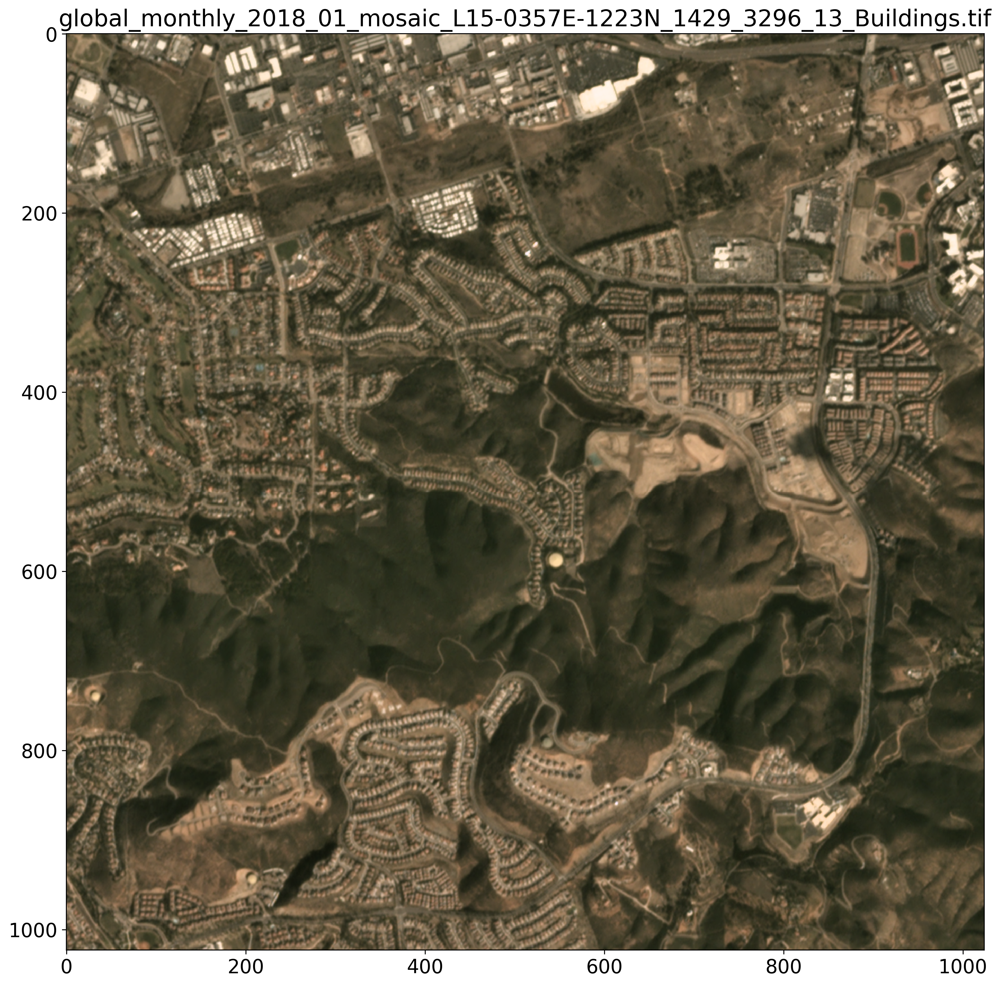

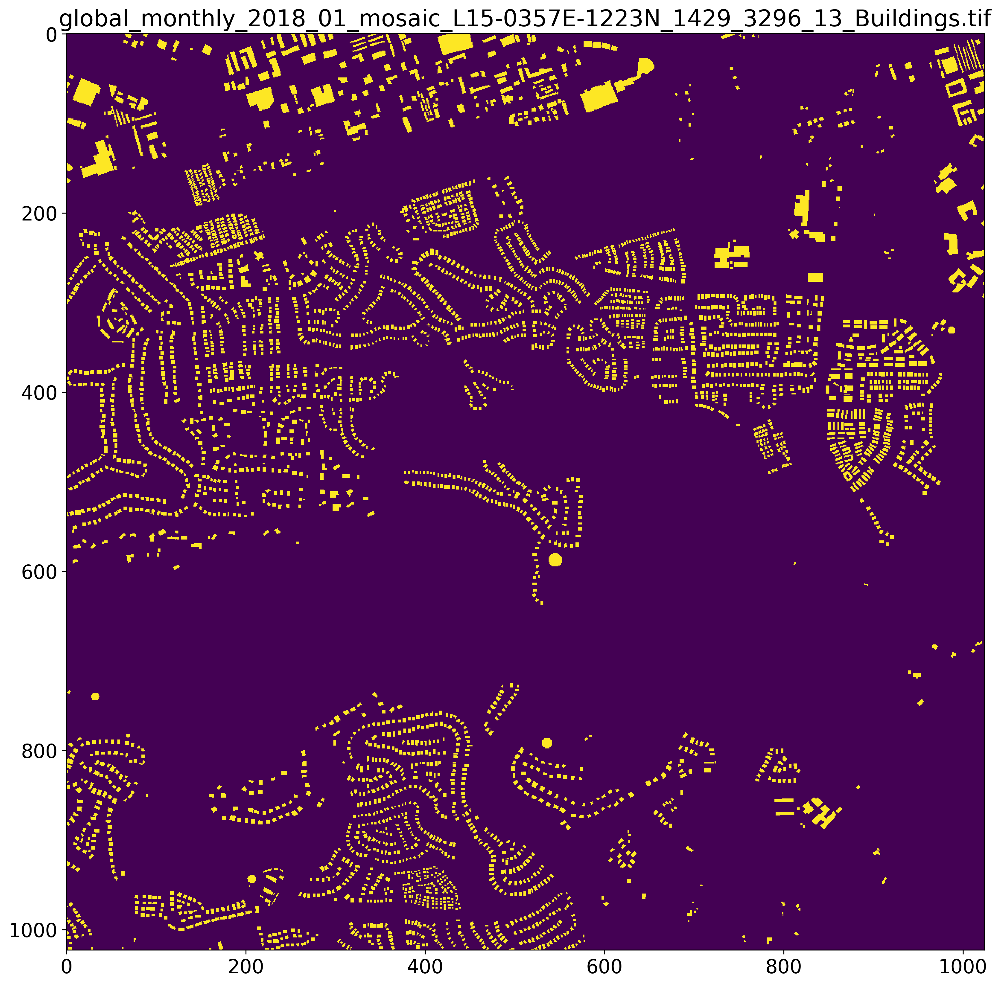

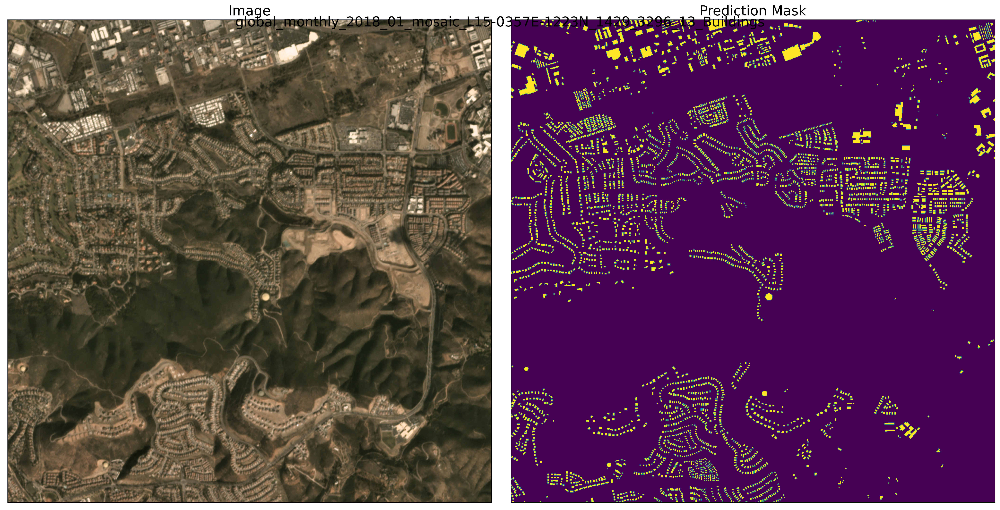

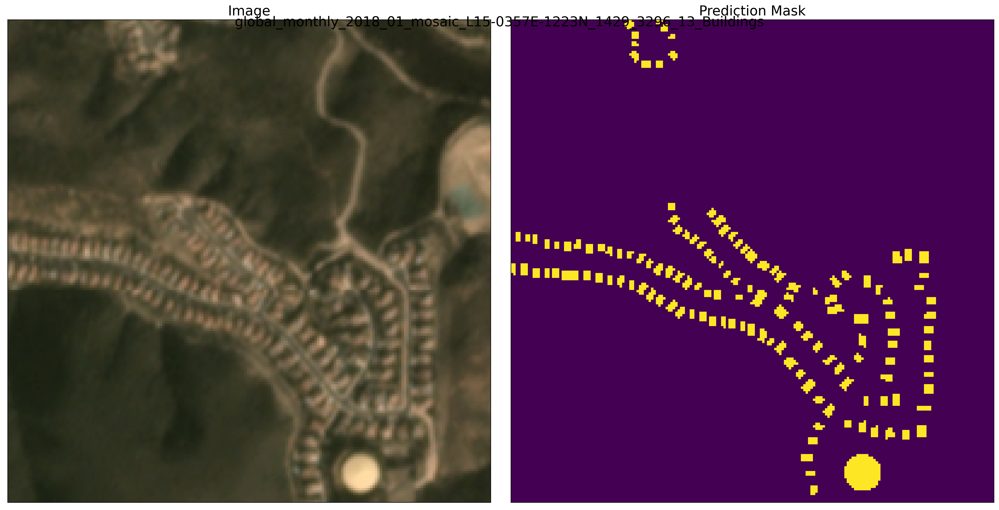

In [36]:

#vertical layout
figsize = (14, 14)
fig, ax = plt.subplots(figsize=figsize)
_ = ax.imshow(image)
ax.set_title(sample_mask_name)
plt.savefig(os.path.join(out_dir_explore, aoi + '_im0.png'))
fig, ax = plt.subplots(figsize=figsize)
_ = ax.imshow(mask_image)
ax.set_title(sample_mask_name)
plt.savefig(os.path.join(out_dir_explore, aoi + '_mask0.png'))
plt.show()

# horizontal 
figsize = (20, 10)
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(image)
ax0.set_xticks([])
ax0.set_yticks([])
ax0.set_title('Image')
_ = ax1.imshow(mask_image)
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Prediction Mask')
plt.suptitle(sample_mask_name.split('.')[0])
plt.tight_layout()
plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0.png'))
plt.show()

# zoom in a subset 
# horizontal 
figsize = (20, 10)
bounds = []
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=figsize)
_ = ax0.imshow(image[400:600,400:600,:])
ax0.set_xticks([])
ax0.set_yticks([])
ax0.set_title('Image')
_ = ax1.imshow(mask_image[400:600,400:600])
ax1.set_xticks([])
ax1.set_yticks([])
ax1.set_title('Prediction Mask')
plt.suptitle(sample_mask_name.split('.')[0])
plt.tight_layout()
plt.savefig(os.path.join(out_dir_explore, aoi + '_im0+mask0_zoom.png'))
plt.show()

output_path_pred:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/explore/L15-0357E-1223N_1429_3296_13/L15-0357E-1223N_1429_3296_13_pred0.geojson
bg_threshold: 0
min_area: 3.5


,geometry,value
0,"POLYGON ((65.000 0.000, 65.000 2.000, 66.000 2...",255.0
1,"POLYGON ((492.000 0.000, 492.000 1.000, 497.00...",255.0
2,"POLYGON ((87.000 0.000, 87.000 1.000, 86.000 1...",255.0
3,"POLYGON ((751.000 1.000, 751.000 2.000, 750.00...",255.0
4,"POLYGON ((766.000 1.000, 766.000 2.000, 765.00...",255.0


N geoms: 4319


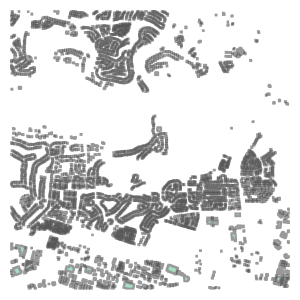

In [37]:

# Extract and inspect sample footprints
# https://solaris.readthedocs.io/en/latest/tutorials/notebooks/api_mask_to_vector.html
# https://github.com/CosmiQ/solaris/blob/master/solaris/vector/mask.py#L718

output_path_pred = os.path.join(out_dir_explore, aoi + '_pred0.geojson')
min_area = 3.5    # in pixels
bg_threshold = 0
simplify = False
print("output_path_pred: ",output_path_pred)
print("bg_threshold:", bg_threshold)
print("min_area:", min_area)
geoms = sol.vector.mask.mask_to_poly_geojson(mask_image, 
                                             min_area=min_area, 
                                             output_path=output_path_pred,
                                             output_type='geojson',
                                             bg_threshold=bg_threshold,
                                             simplify=simplify)
display(geoms.head())
print("N geoms:", len(geoms))

# get plot geoms
plot_geoms = cascaded_union(geoms['geometry'])
display(plot_geoms)

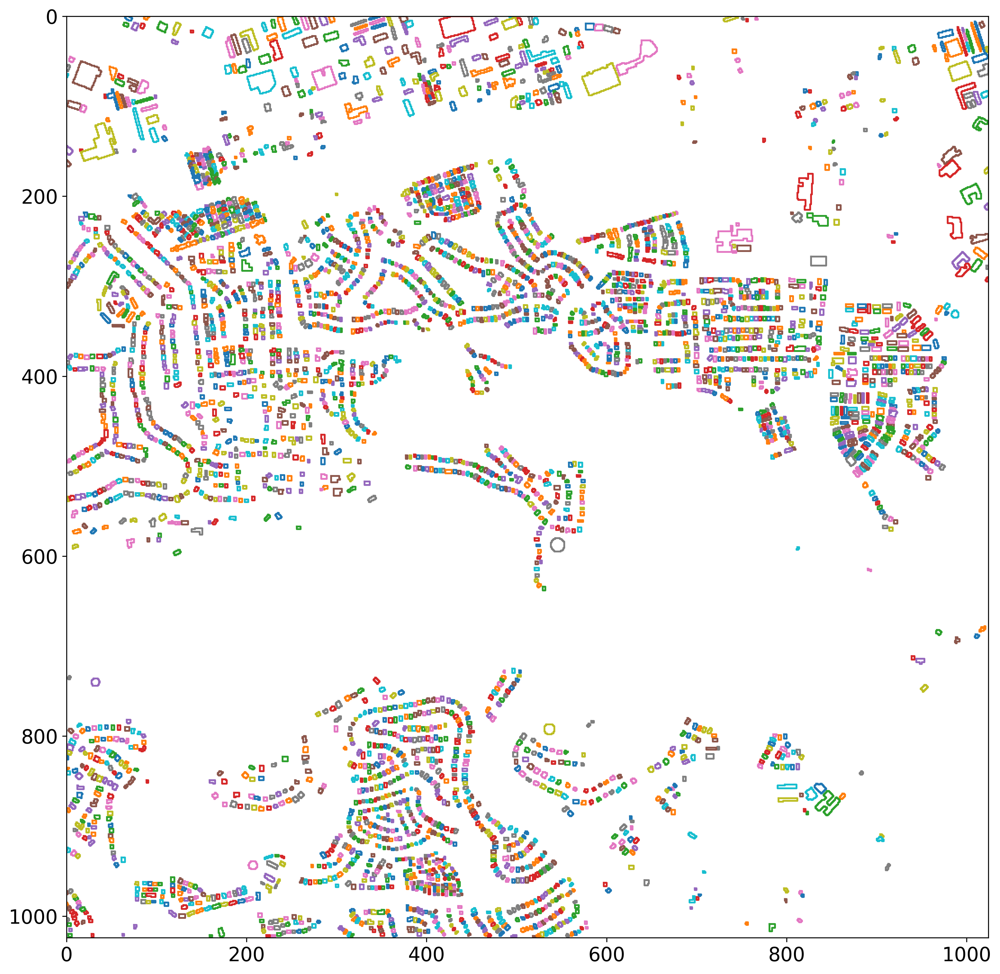

In [38]:
# Plot each polygon shape
fig, ax = plt.subplots(figsize=(14, 14))
for geom in plot_geoms.geoms:
    ax.plot(*geom.exterior.xy)
ax.set_xlim(0, mask_image.shape[1])
ax.set_ylim(mask_image.shape[1], 0)
ax.set_aspect('equal')
# Set (current) axis to be equal before showing plot?
# plt.gca().axis("equal")
plt.savefig(os.path.join(out_dir_explore, aoi + '_footprints0.png'))
plt.show()

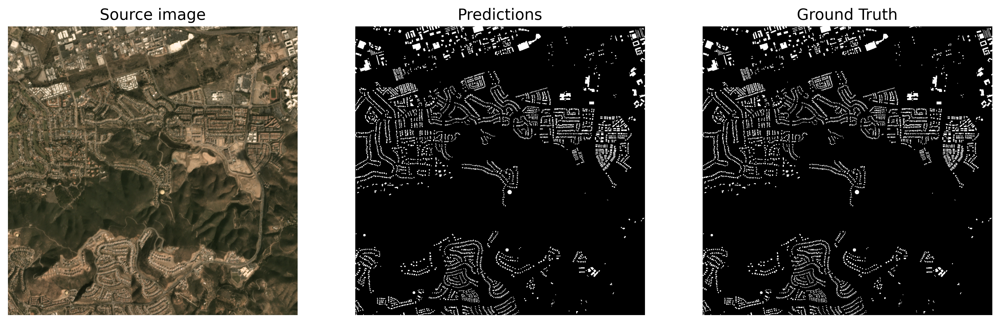

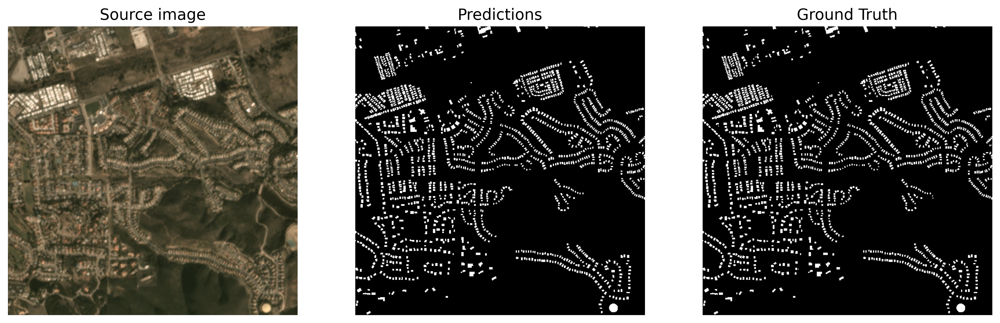

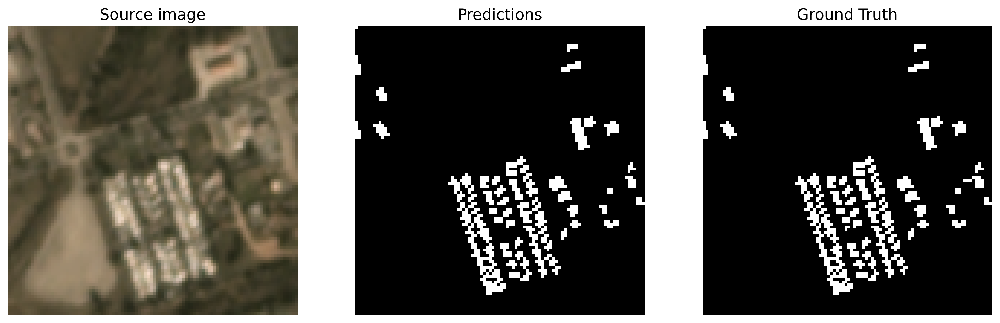

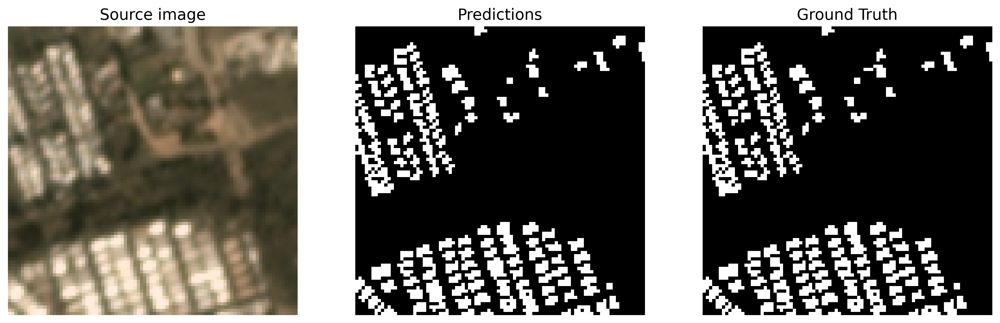

In [39]:
# Original image

#data_path = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET"
data_path = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/images/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13.tif"
#src_im_path = os.path.join(data_path, 'MVOI_data/MVOI_nadir10_test_sample.tif')
src_im_path = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/images/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13.tif"

im_arr = skimage.io.imread(data_path)
#pred = skimage.io.imread(os.path.join(sample_mask_path))

pred_arr = sol.vector.mask.footprint_mask(geoms,
                                          reference_im=src_im_path)
ground_truth = skimage.io.imread("/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/masks/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13.tif")
 #ground_truth = sol.vector.mask.footprint_mask(
    # geojson fomat
  #  os.path.join("/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train/validation_final/L15-0357E-1223N_1429_3296_13/labels/global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13.geojson"),
    # img
   # reference_im=src_im_path)
f, axarr = plt.subplots(1, 3, figsize=(16, 12))
axarr[0].imshow(im_arr[:, :, 0:3])
axarr[0].set_title('Source image', size=14)
axarr[0].axis('off')
axarr[1].imshow(pred_arr, cmap='gray')
axarr[1].set_title('Predictions', size=14)
axarr[1].axis('off')
axarr[2].imshow(ground_truth, cmap='gray') # _ = ax1.imshow(mask_image[400:600,400:600])
axarr[2].set_title('Ground Truth', size=14);
axarr[2].axis('off');


f, axarr = plt.subplots(1, 3, figsize=(16, 12))
axarr[0].imshow(im_arr[100:600,100:600, 0:3])
axarr[0].set_title('Source image', size=14)
axarr[0].axis('off')
axarr[1].imshow(pred_arr[100:600,100:600], cmap='gray')
axarr[1].set_title('Predictions', size=14)
axarr[1].axis('off')
axarr[2].imshow(ground_truth[100:600,100:600], cmap='gray') # _ = ax1.imshow(mask_image[400:600,400:600])
axarr[2].set_title('Ground Truth', size=14);
axarr[2].axis('off');

f, axarr = plt.subplots(1, 3, figsize=(16, 12))
axarr[0].imshow(im_arr[100:200,100:200, 0:3])
axarr[0].set_title('Source image', size=14)
axarr[0].axis('off')
axarr[1].imshow(pred_arr[100:200,100:200], cmap='gray')
axarr[1].set_title('Predictions', size=14)
axarr[1].axis('off')
axarr[2].imshow(ground_truth[100:200,100:200], cmap='gray') # _ = ax1.imshow(mask_image[400:600,400:600])
axarr[2].set_title('Ground Truth', size=14);
axarr[2].axis('off');

inval = 140
outval = 230

f, axarr = plt.subplots(1, 3, figsize=(16, 12))
axarr[0].imshow(im_arr[inval:outval,inval:outval, 0:3])
axarr[0].set_title('Source image', size=14)
axarr[0].axis('off')
axarr[1].imshow(pred_arr[inval:outval,inval:outval], cmap='gray')
axarr[1].set_title('Predictions', size=14)
axarr[1].axis('off')
axarr[2].imshow(ground_truth[inval:outval,inval:outval], cmap='gray') # _ = ax1.imshow(mask_image[400:600,400:600])
axarr[2].set_title('Ground Truth', size=14);
axarr[2].axis('off');



# Generate ID + polygons for validation set

In [40]:
# Get all geoms for all aois (mult-threaded)

min_area = 3.5   # in pixels (4 is standard)
simplify = False
bg_threshold = 0  
output_type = 'geojson'
d = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped"

aoi = sorted([f for f in os.listdir(d) if os.path.isdir(os.path.join(d, f))])

print("pred_top_dir",pred_top_dir)

aois = aoi[1:]

print("aoi: ", aoi)

pred_top_dir /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds
aoi:  ['.ipynb_checkpoints', 'L15-0357E-1223N_1429_3296_13', 'L15-0358E-1220N_1433_3310_13', 'L15-0361E-1300N_1446_2989_13', 'L15-0368E-1245N_1474_3210_13', 'L15-0387E-1276N_1549_3087_13', 'L15-0434E-1218N_1736_3318_13', 'L15-0457E-1135N_1831_3648_13', 'L15-0487E-1246N_1950_3207_13', 'L15-0506E-1204N_2027_3374_13', 'L15-0544E-1228N_2176_3279_13', 'L15-0566E-1185N_2265_3451_13', 'L15-0571E-1075N_2287_3888_13', 'L15-0577E-1243N_2309_3217_13', 'L15-0586E-1127N_2345_3680_13', 'L15-0595E-1278N_2383_3079_13', 'L15-0614E-0946N_2459_4406_13', 'L15-0632E-0892N_2528_4620_13', 'L15-0683E-1006N_2732_4164_13', 'L15-0760E-0887N_3041_4643_13', 'L15-0924E-1108N_3699_3757_13', 'L15-0977E-1187N_3911_3441_13', 'L15-1014E-1375N_4056_2688_13', 'L15-1015E-1062N_4061_3941_13', 'L15-1025E-1366N_4102_2726_13', 'L15-1049E-1370N_4196_2710_13', 'L15-1138E-1216N_4553_3325_13', 'L15-1172E-1306N_4

In [41]:
print(len(aoi))
for i, aoi in enumerate(aois):
  print(i,aoi)

59
0 L15-0357E-1223N_1429_3296_13
1 L15-0358E-1220N_1433_3310_13
2 L15-0361E-1300N_1446_2989_13
3 L15-0368E-1245N_1474_3210_13
4 L15-0387E-1276N_1549_3087_13
5 L15-0434E-1218N_1736_3318_13
6 L15-0457E-1135N_1831_3648_13
7 L15-0487E-1246N_1950_3207_13
8 L15-0506E-1204N_2027_3374_13
9 L15-0544E-1228N_2176_3279_13
10 L15-0566E-1185N_2265_3451_13
11 L15-0571E-1075N_2287_3888_13
12 L15-0577E-1243N_2309_3217_13
13 L15-0586E-1127N_2345_3680_13
14 L15-0595E-1278N_2383_3079_13
15 L15-0614E-0946N_2459_4406_13
16 L15-0632E-0892N_2528_4620_13
17 L15-0683E-1006N_2732_4164_13
18 L15-0760E-0887N_3041_4643_13
19 L15-0924E-1108N_3699_3757_13
20 L15-0977E-1187N_3911_3441_13
21 L15-1014E-1375N_4056_2688_13
22 L15-1015E-1062N_4061_3941_13
23 L15-1025E-1366N_4102_2726_13
24 L15-1049E-1370N_4196_2710_13
25 L15-1138E-1216N_4553_3325_13
26 L15-1172E-1306N_4688_2967_13
27 L15-1185E-0935N_4742_4450_13
28 L15-1200E-0847N_4802_4803_13
29 L15-1203E-1203N_4815_3378_13
30 L15-1204E-1204N_4819_3372_13
31 L15-1209E-11

In [42]:

# set params
params = []
for i, aoi in enumerate(aois):
      print(i, "/", len(aois), aoi)   
      outdir = os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons')
      print(outdir)
      os.makedirs(outdir, exist_ok=True)
      pred_files = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'masks', f)
                  for f in sorted(os.listdir(os.path.join(pred_top_dir, 'grouped', aoi, 'masks')))
                  if f.endswith('.tif')])
      for j, p in enumerate(pred_files):
          name = os.path.basename(p)
          # print(i, j, name)
          output_path_pred = os.path.join(outdir,  name.split('.tif')[0] + '.geojson')
          # get pred geoms
          if not os.path.exists(output_path_pred):
              pred_image = skimage.io.imread(p)#[:,:,0]
              params.append([pred_image, min_area, output_path_pred,
                            output_type, bg_threshold, simplify])        

print("Execute!")
print("len params:", len(params))
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(multithread_polys, params)

0 / 58 L15-0357E-1223N_1429_3296_13
/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0357E-1223N_1429_3296_13/pred_jsons
1 / 58 L15-0358E-1220N_1433_3310_13
/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0358E-1220N_1433_3310_13/pred_jsons
2 / 58 L15-0361E-1300N_1446_2989_13
/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0361E-1300N_1446_2989_13/pred_jsons
3 / 58 L15-0368E-1245N_1474_3210_13
/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0368E-1245N_1474_3210_13/pred_jsons
4 / 58 L15-0387E-1276N_1549_3087_13
/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0387E-1276N_1549_3087_13/pred_jsons
5 / 58 L15-0434E-1218N_1736_3318_13
/con

In [43]:
min_iou = 0.2
iou_field = 'iou_score'
id_field = 'Id'
reverse_order = False
verbose = True
super_verbose = False
n_threads = 10

json_dir_name = 'pred_jsons/'
out_dir_name = 'pred_jsons_match/'
aois = sorted([f for f in os.listdir(os.path.join(pred_top_dir, 'grouped')) 
               if os.path.isdir(os.path.join(pred_top_dir, 'grouped', f))])
print("aois:", aois)

print("Gather data for matching...")
params = []
for aoi in aois:
    print(aoi)
    json_dir = os.path.join(pred_top_dir, 'grouped', aoi, json_dir_name)
    out_dir = os.path.join(pred_top_dir, 'grouped', aoi, out_dir_name)
    
    # check if we started matching...
    if os.path.exists(out_dir):
        # print("  outdir exists:", outdir)
        json_files = sorted([f
                for f in os.listdir(os.path.join(json_dir))
                if f.endswith('.geojson') and os.path.exists(os.path.join(json_dir, f))])
        out_files_tmp = sorted([z for z in os.listdir(out_dir) if z.endswith('.geojson')])
        if len(out_files_tmp) > 0:
            if len(out_files_tmp) == len(json_files):
                print("Dir:", os.path.basename(out_dir), "N files:", len(json_files), 
                      "directory matching completed, skipping...")
                continue
            elif len(out_files_tmp) != len(json_files):
                # raise Exception("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                #                 "files (should have N_gt =", 
                #                 len(json_files), "), need to purge this folder and restart matching!")
                print("Incomplete matching in:", out_dir, "with N =", len(out_files_tmp), 
                                "files (should have N_gt =", 
                                len(json_files), "), purging this folder and restarting matching!")
                purge_cmd = 'rm -r ' + out_dir
                print("  purge_cmd:", purge_cmd)
                if len(out_dir) > 20:
                    purge_cmd = 'rm -r ' + out_dir
                else:
                    raise Exception("out_dir too short, maybe deleting something unintentionally...")
                    break
                os.system(purge_cmd)
            else:
                pass

    params.append([track_footprint_identifiers, json_dir,  out_dir, min_iou, 
                   iou_field, id_field, reverse_order, verbose, super_verbose])    

print("Len params:", len(params))

aois: ['.ipynb_checkpoints', 'L15-0357E-1223N_1429_3296_13', 'L15-0358E-1220N_1433_3310_13', 'L15-0361E-1300N_1446_2989_13', 'L15-0368E-1245N_1474_3210_13', 'L15-0387E-1276N_1549_3087_13', 'L15-0434E-1218N_1736_3318_13', 'L15-0457E-1135N_1831_3648_13', 'L15-0487E-1246N_1950_3207_13', 'L15-0506E-1204N_2027_3374_13', 'L15-0544E-1228N_2176_3279_13', 'L15-0566E-1185N_2265_3451_13', 'L15-0571E-1075N_2287_3888_13', 'L15-0577E-1243N_2309_3217_13', 'L15-0586E-1127N_2345_3680_13', 'L15-0595E-1278N_2383_3079_13', 'L15-0614E-0946N_2459_4406_13', 'L15-0632E-0892N_2528_4620_13', 'L15-0683E-1006N_2732_4164_13', 'L15-0760E-0887N_3041_4643_13', 'L15-0924E-1108N_3699_3757_13', 'L15-0977E-1187N_3911_3441_13', 'L15-1014E-1375N_4056_2688_13', 'L15-1015E-1062N_4061_3941_13', 'L15-1025E-1366N_4102_2726_13', 'L15-1049E-1370N_4196_2710_13', 'L15-1138E-1216N_4553_3325_13', 'L15-1172E-1306N_4688_2967_13', 'L15-1185E-0935N_4742_4450_13', 'L15-1200E-0847N_4802_4803_13', 'L15-1203E-1203N_4815_3378_13', 'L15-1204E-

In [44]:
print("Execute!")
n_threads = 10
pool = multiprocessing.Pool(n_threads)
_ = pool.map(map_wrapper, params)

Execute!

Matching json_dir: 
Matching json_dir: 
Matching json_dir:   N json: 0

Matching json_dir:   N json: 0

Matching json_dir: 
Matching json_dir: 
Matching json_dir:   N json: 0

Matching json_dir: 
Matching json_dir:   N json: 0

Matching json_dir:   N json: 0
  N json: 0
  N json: 0

Matching json_dir:   N json: 0

Matching json_dir:   N json: 0

Matching json_dir:   N json: 0

Matching json_dir:   N json: 0
  N json: 0
  N json: 0

Matching json_dir:   N json: 0

Matching json_dir:   N json: 0

Matching json_dir: 
Matching json_dir: 
Matching json_dir: 
Matching json_dir:   N json: 0
  N json: 0

Matching json_dir: 
Matching json_dir:   N json: 0
  N json: 0
  N json: 0
  N json: 0

Matching json_dir: 
Matching json_dir:   N json: 0
  N json: 0
  N json: 0

Matching json_dir: 
Matching json_dir:   N json: 0

Matching json_dir: 
Matching json_dir: 
Matching json_dir: 
Matching json_dir: 
Matching json_dir:   N json: 0

Matching json_dir: 
Matching json_dir:   N json: 0
  N jso

In [45]:
# Make proposal csv

out_dir_csv = os.path.join(pred_top_dir, 'csvs')
print("out_dir_csv: ", out_dir_csv)
os.makedirs(out_dir_csv, exist_ok=True)
prop_file = os.path.join(out_dir_csv, 'sn7_baseline_predictions_validation.csv')
print("prop_file: ",prop_file)
aoi_dirs = sorted([os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match') \
                   for aoi in os.listdir(os.path.join(pred_top_dir, 'grouped')) \
                   if os.path.isdir(os.path.join(pred_top_dir, 'grouped', aoi, 'pred_jsons_match'))])
print("aoi_dirs:", aoi_dirs)

# Execute
if not os.path.exists(prop_file):
    net_df = sn7_convert_geojsons_to_csv(aoi_dirs, prop_file, 'proposal')

print("prop_file:", prop_file)

out_dir_csv:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs
prop_file:  /content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/sn7_baseline_predictions_validation.csv
aoi_dirs: ['/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/.ipynb_checkpoints/pred_jsons_match', '/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0357E-1223N_1429_3296_13/pred_jsons_match', '/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0358E-1220N_1433_3310_13/pred_jsons_match', '/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/grouped/L15-0361E-1300N_1446_2989_13/pred_jsons_match', '/content/drive/MyDrive/Colab Notebooks/SPACENE

In [7]:
import pandas as pd
df_val = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/sn7_baseline_predictions_validation.csv")
df_train = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/sn7_train_ground_truth_pix.csv")

In [8]:
print(len(df_val))
print(len(df_train))
print(len(df_train) - len(df_val) )

111145
6664652
6553507


#Funtions to evaluate through SCOT metric [ref](https://www.topcoder.com/challenges/21ba3d19-3f7a-4abc-8d28-7c932887f0f6): 

https://github.com/CosmiQ/solaris/blob/master/solaris/eval/scot.py 



In [9]:
df_val_test = df_val.copy()
df_val_test['filename'] = df_val_test['filename'].map(lambda x: str(x)[:-10]) # remove _Bulding ending
df_val_test

,filename,id,geometry
0,global_monthly_2018_01_mosaic_L15-0357E-1223N_...,0,"POLYGON ((605 52, 605 53, 603 53, 603 54, 600 ..."
1,global_monthly_2018_01_mosaic_L15-0357E-1223N_...,1,"POLYGON ((39 119, 39 120, 35 120, 35 121, 32 1..."
2,global_monthly_2018_01_mosaic_L15-0357E-1223N_...,2,"POLYGON ((426 0, 426 1, 423 1, 423 2, 419 2, 4..."
3,global_monthly_2018_01_mosaic_L15-0357E-1223N_...,3,"POLYGON ((16 50, 16 52, 15 52, 15 54, 14 54, 1..."
4,global_monthly_2018_01_mosaic_L15-0357E-1223N_...,4,"POLYGON ((738 233, 738 239, 724 239, 724 246, ..."
...,...,...,...
111140,global_monthly_2020_01_mosaic_L15-0357E-1223N_...,4258,"POLYGON ((330 905, 330 907, 332 907, 332 905, ..."
111141,global_monthly_2020_01_mosaic_L15-0357E-1223N_...,4245,"POLYGON ((724 407, 724 409, 726 409, 726 407, ..."
111142,global_monthly_2020_01_mosaic_L15-0357E-1223N_...,4311,"POLYGON ((702 976, 702 977, 703 977, 703 978, ..."
111143,global_monthly_2020_01_mosaic_L15-0357E-1223N_...,4287,"POLYGON ((623 292, 623 294, 625 294, 625 292, ..."


In [10]:
a = len(df_train) - len(df_val)
df_truth = df_train[:len(df_val)]
print("len(df_truth) : ", len(df_truth))
print("len(df_val) : ", len(df_val_test))

len(df_truth) :  111145
len(df_val) :  111145


In [81]:
df_val_test['filename'][0]

'global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13'

In [82]:
df_truth['filename'][0]

'global_monthly_2018_01_mosaic_L15-0331E-1257N_1327_3160_13'

In [11]:
df_val_test.to_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/df_val_test.csv")
df_truth.to_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/truncated_truth_111145.csv")

In [12]:
preds_csv="/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/df_val_test.csv"
truth_csv="/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/truncated_truth_111145.csv"
sol.eval.challenges.multi_temporal_buildings("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/df_val_test.csv", "/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/truncated_truth_111145.csv")

0.4629012942001803

In [13]:
df_validation = df_val.copy()
df_validation = df_validation['filename'].map(lambda x: str(x)[:-10]) # remove _Bulding ending
df_validation = pd.DataFrame(df_validation)
pool = df_validation.groupby('filename').count()
pool

""
filename
global_monthly_2018_01_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_02_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_03_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_04_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_05_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_06_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_07_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_08_mosaic_L15-0357E-1223N_1429_3296_13
global_monthly_2018_09_mosaic_L15-0357E-1223N_1429_3296_13


# Other comparaisons.. 

Storing over dataframe initialized on nans

In [ ]:
#df_truth = df_truth.sort_index(axis=1)
#df_truth.reset_index(inplace=True)
#df_truth.drop(columns=['index'],inplace=True)
#df_truth.groupby('filename').count()
df_validation = df_val.copy()
df_validation = df_validation['filename'].map(lambda x: str(x)[:-10]) # remove _Bulding ending
df_validation = df_validation.tolist()

df = pd.DataFrame(index=range(0,len(df_train)),columns=['filename'])

for i in range(len(df_train)):
  if i<len(df_validation):
      print(i,len(df_train))
      df['filename'][i] = df_validation[i]
df.to_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/df.csv")
is_truth  = df_train[df_train.filename == df['filename']]
df_ = df_train[is_truth] # and this would fit the pd
df_truth = df_train[df_train['filename'] == pool ]
df = pd.DataFrame(index=range(0,len(df_train)),columns=['filename'])
print("len(df_validation): ",len(df_validation))
for i in range(len(df_train)):

  if i<=len(df_validation):
    
    df['filename'][i] = df_validation[i]
    print(i,len(df_train))
is_truth  = df_train[df_train.filename == df['filename']]
df_ = df_train[is_truth] # and this would fit the pd
# Merge both datasets by filename, since the same are the same, there will be many Nans, then drop rows containning nans and then separate both datasets
di = df_train.merge(df_val_test[['filename']], how='left')

# create csv from training set

dir = "/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train"

aoi = sorted([f for f in os.listdir(os.path.join(dir,'validation_final')) 
               if os.path.isdir(os.path.join(dir,'validation_final',f))])

# Another test

# Make proposal csv - training
print(pred_top_dir)
out_dir_csv = os.path.join(pred_top_dir, 'csvs')
print("out_dir_csv: ", out_dir_csv)
os.makedirs(out_dir_csv, exist_ok=True)

prop_file = os.path.join(out_dir_csv, 'val_from_csv.csv')
print("prop_file: ",prop_file)

aoi_dirs = sorted([os.path.join(dir,'validation_final', aoi, 'labels_match_pix') \
                   for aoi in os.listdir(os.path.join(dir, 'validation_final')) \
                   if os.path.isdir(os.path.join(dir, 'validation_final', aoi, 'labels_match_pix'))])


def convertir_csv(json_dirs, output_csv_path, population='proposal'):
    '''
    Convert jsons to csv
    Population is either "ground" or "proposal" 
    '''
    
    first_file = True  # switch that will be turned off once we process the first file
    for json_dir in tqdm.tqdm(json_dirs):
        json_files = sorted(glob.glob(os.path.join(json_dir, '*.geojson')))
        for json_file in tqdm.tqdm(json_files):
            try:
                df = gpd.read_file(json_file)
                
                print(df.columns)
            except (fiona.errors.DriverError):
                message = '! Invalid dataframe for %s' % json_file
                #print(message)
                continue
                #raise Exception(message)
            if population == 'ground':
                file_name_col = df.image_fname.apply(lambda x: os.path.splitext(x)[0])
            elif population == 'proposal':
                file_name_col = os.path.splitext(os.path.basename(json_file))[0]
            else:
                raise Exception('! Invalid population')
            #if not df.Id.astype(int).empty and :
            if {'filename', 'id','geometry'}.issubset(df.columns):
              df = gpd.GeoDataFrame({
                  'filename': file_name_col,
                  'id': df.Id.astype(int),
                  'geometry': df.geometry,})
            if len(df) == 0:
                message = '! Empty dataframe for %s' % json_file
                #print(message)
                #raise Exception(message)

            if first_file:
                net_df = df
                first_file = False
            else:
                net_df = net_df.append(df)
                
    net_df.to_csv(output_csv_path, index=False)
    return net_df

df_true_Val = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SPACENET7/CosmiQ_SN7_Baseline/inference_out_final/sn7_baseline_preds/csvs/val_from_csv.csv")